## Part 0: Setting up a github repository

Github repo link: https://github.com/toanlc01/Project-8

## Part 1: Extracting timestamps from your personal data

Import the necessary libraries:

In [3]:
import pandas as pd
from bs4 import BeautifulSoup

Open the HTML file and read its contents:

In [4]:
with open('watch-history.html', 'r', encoding='utf8') as file:
    contents = file.read()

In [5]:
soup = BeautifulSoup(contents, 'lxml')

In [6]:
soup

<html><head><title>My Activity History</title><style type="text/css">/**
 * material-design-lite - Material Design Components in CSS, JS and HTML
 * @version v1.3.0
 * @license Apache-2.0
 * @copyright 2015 Google, Inc.
 * @link https://github.com/google/material-design-lite
 */
@charset "UTF-8";html{color:rgba(0,0,0,.87)}::-moz-selection{background:#b3d4fc;text-shadow:none}::selection{background:#b3d4fc;text-shadow:none}hr{display:block;height:1px;border:0;border-top:1px solid #ccc;margin:1em 0;padding:0}audio,canvas,iframe,img,svg,video{vertical-align:middle}fieldset{border:0;margin:0;padding:0}textarea{resize:vertical}.browserupgrade{margin:.2em 0;background:#ccc;color:#000;padding:.2em 0}.hidden{display:none!important}.visuallyhidden{border:0;clip:rect(0 0 0 0);height:1px;margin:-1px;overflow:hidden;padding:0;position:absolute;width:1px}.visuallyhidden.focusable:active,.visuallyhidden.focusable:focus{clip:auto;height:auto;margin:0;overflow:visible;position:static;width:auto}.invisi

In [7]:
type(soup)

bs4.BeautifulSoup

In [8]:
date_elements = soup.find_all('div', class_='content-cell')

result = []
length = len(date_elements) // 3
for i in range(length):
    result.append(date_elements[i*3])

In [9]:
result

[<div class="content-cell mdl-cell mdl-cell--6-col mdl-typography--body-1">Watched <a href="https://www.youtube.com/watch?v=QJPk1K1QF-U">NewJeans (뉴진스) 'Ditto' Performance Video (Fix ver.)</a><br/><a href="https://www.youtube.com/channel/UCMki_UkHb4qSc0qyEcOHHJw">NewJeans</a><br/>Apr 21, 2023, 2:12:29 PM PDT</div>,
 <div class="content-cell mdl-cell mdl-cell--6-col mdl-typography--body-1">Watched <a href="https://www.youtube.com/watch?v=BEj8KOOoL3M">Save the Last Dance for Me</a><br/><a href="https://www.youtube.com/channel/UCJWJd67r42sByfpOe6S__zw">Michael Bublé - Topic</a><br/>Apr 21, 2023, 1:52:37 PM PDT</div>,
 <div class="content-cell mdl-cell mdl-cell--6-col mdl-typography--body-1">Watched <a href="https://www.youtube.com/watch?v=QXQaTfWql8M">Everything</a><br/><a href="https://www.youtube.com/channel/UCJWJd67r42sByfpOe6S__zw">Michael Bublé - Topic</a><br/>Apr 21, 2023, 1:49:05 PM PDT</div>,
 <div class="content-cell mdl-cell mdl-cell--6-col mdl-typography--body-1">Watched <a hre

In [11]:
timestamps = []
for div in result:
    timestamp = div.contents[-1].strip()
    timestamps.append(timestamp)

In [12]:
timestamps

['Apr 21, 2023, 2:12:29\u202fPM PDT',
 'Apr 21, 2023, 1:52:37\u202fPM PDT',
 'Apr 21, 2023, 1:49:05\u202fPM PDT',
 'Apr 21, 2023, 1:38:02\u202fPM PDT',
 'Apr 21, 2023, 1:05:30\u202fPM PDT',
 'Apr 21, 2023, 1:01:06\u202fPM PDT',
 'Apr 21, 2023, 12:57:57\u202fPM PDT',
 'Apr 21, 2023, 12:54:03\u202fPM PDT',
 'Apr 21, 2023, 12:50:53\u202fPM PDT',
 'Apr 21, 2023, 12:47:46\u202fPM PDT',
 'Apr 21, 2023, 12:43:30\u202fPM PDT',
 'Apr 21, 2023, 12:39:49\u202fPM PDT',
 'Apr 21, 2023, 12:36:13\u202fPM PDT',
 'Apr 21, 2023, 12:32:28\u202fPM PDT',
 'Apr 21, 2023, 12:28:48\u202fPM PDT',
 'Apr 21, 2023, 12:25:01\u202fPM PDT',
 'Apr 21, 2023, 12:21:27\u202fPM PDT',
 'Apr 21, 2023, 12:17:41\u202fPM PDT',
 'Apr 21, 2023, 2:00:33\u202fAM PDT',
 'Apr 21, 2023, 1:57:04\u202fAM PDT',
 'Apr 21, 2023, 1:55:12\u202fAM PDT',
 'Apr 21, 2023, 1:12:11\u202fAM PDT',
 'Apr 21, 2023, 1:12:01\u202fAM PDT',
 'Apr 21, 2023, 1:07:20\u202fAM PDT',
 'Apr 21, 2023, 1:03:29\u202fAM PDT',
 'Apr 20, 2023, 10:49:46\u202fPM PDT',

In [13]:
df = pd.DataFrame({'timestamp': timestamps})

csv_file_path = 'timestamps.csv'
df.to_csv(csv_file_path, index=False)

## Part 2: Analyzing timestamp data for patterns

In [14]:
df = pd.read_csv("timestamps.csv")

In [15]:
df

,timestamp
0,"Apr 21, 2023, 2:12:29 PM PDT"
1,"Apr 21, 2023, 1:52:37 PM PDT"
2,"Apr 21, 2023, 1:49:05 PM PDT"
3,"Apr 21, 2023, 1:38:02 PM PDT"
4,"Apr 21, 2023, 1:05:30 PM PDT"
...,...
38095,"Mar 31, 2022, 12:14:53 AM PDT"
38096,"Mar 31, 2022, 12:10:30 AM PDT"
38097,"Mar 31, 2022, 12:08:00 AM PDT"
38098,"Mar 31, 2022, 12:06:46 AM PDT"


### Convert to standard date

1. Make sure the timestamp is in the datetime format (for example, by using pandas.to_datetime)

In [16]:
df['timestamp'] = df['timestamp'].str.replace(r'\sPDT$', '')

/var/folders/bs/qfl9ywrn26v4bm2ddlmj87yw0000gn/T/ipykernel_40676/2990491259.py:1: FutureWarning: The default value of regex will change from True to False in a future version.
  df['timestamp'] = df['timestamp'].str.replace(r'\sPDT$', '')


In [17]:
df

,timestamp
0,"Apr 21, 2023, 2:12:29 PM"
1,"Apr 21, 2023, 1:52:37 PM"
2,"Apr 21, 2023, 1:49:05 PM"
3,"Apr 21, 2023, 1:38:02 PM"
4,"Apr 21, 2023, 1:05:30 PM"
...,...
38095,"Mar 31, 2022, 12:14:53 AM"
38096,"Mar 31, 2022, 12:10:30 AM"
38097,"Mar 31, 2022, 12:08:00 AM"
38098,"Mar 31, 2022, 12:06:46 AM"


In [18]:
df['timestamp'] = pd.to_datetime(df['timestamp'])

In [19]:
df

,timestamp
0,2023-04-21 14:12:29
1,2023-04-21 13:52:37
2,2023-04-21 13:49:05
3,2023-04-21 13:38:02
4,2023-04-21 13:05:30
...,...
38095,2022-03-31 00:14:53
38096,2022-03-31 00:10:30
38097,2022-03-31 00:08:00
38098,2022-03-31 00:06:46


2. Using pandas.diff(), make a new column that tells you the time since between a timestamp and the previous one (for example, row 2 will have the time between the timestamp in row 2 and row 1). (TIP: Make sure your timestamps are sorted in chronological order before you do this!)

In [20]:
df.sort_values('timestamp', inplace=True)

In [21]:
df['time_diff'] = df['timestamp'].diff()

In [22]:
df

,timestamp,time_diff
38099,2022-03-30 23:57:13,NaT
38098,2022-03-31 00:06:46,0 days 00:09:33
38097,2022-03-31 00:08:00,0 days 00:01:14
38096,2022-03-31 00:10:30,0 days 00:02:30
38095,2022-03-31 00:14:53,0 days 00:04:23
...,...,...
4,2023-04-21 13:05:30,0 days 00:04:24
3,2023-04-21 13:38:02,0 days 00:32:32
2,2023-04-21 13:49:05,0 days 00:11:03
1,2023-04-21 13:52:37,0 days 00:03:32


3. Answer: What is the longest time between timestamps? What is the average time between timestamps?

In [23]:
longest_time = df['time_diff'].max()

In [24]:
longest_time

Timedelta('0 days 20:42:49')

In [25]:
print(f"the longest time between timestamps is {longest_time}")

the longest time between timestamps is 0 days 20:42:49


4. Answer: What is the day with the most timestamps? How many events (timestamps) were on that day? (TIP: Once you have done .to_datetime, you now have a Timestamp object, which has all kinds of cool properties and methods -- such as returning the day or the month. Find out more here. You might also want to use DatetimeIndex. For example, you can create a new column that is the day by doing: df['days'] = pd.DatetimeIndex(df['timestamps']).day )

In [26]:
date_counts = df.groupby(df['timestamp'].dt.date).size()

max_date = date_counts.idxmax()
max_count = date_counts[max_date]

# print the result
print(f"The day with the most timestamps is {max_date}, with {max_count} timestamps.")

The day with the most timestamps is 2023-04-01, with 430 timestamps.


5. Answer: What is the month with the most timestamps? How many events (timestamps) were on that month?

In [27]:
month_counts = df.groupby(df['timestamp'].dt.month).size()

# find the month with the most timestamps and the number of timestamps in that month
max_month = month_counts.idxmax()
max_count = month_counts[max_month]

# print the result
print(f"The month with the most timestamps is {max_month}, with {max_count} timestamps.")

The month with the most timestamps is 4, with 5334 timestamps.


6. Answer: What do you think the source of this data is? Write a few sentences explaining your reasoning. What other data might help you verify if you are correct?

In [28]:
date_counts.quantile()

92.0

In [29]:
date_counts.quantile(0.25)

61.75

In [30]:
date_counts.quantile(0.75)

122.0

- Based on the distribution of the date counts, it appears that the individual uses this application frequently, likely on a daily basis, as evidenced by the median of 92 and the 25th and 75th percentiles of 62 and 122, respectively. The nature of the usage may involve audio or short video consumption, which suggests that the data source could be one of several music and video streaming platforms, such as Spotify, Youtube, Apple Music, Amazon Music, or Youtube Music.

7. Exchange your analysis with your partner. Read your partner's analysis -- does it seem accurate? Did they guess the correct data source (or type of data source)?

- It seems accurate and my partner's data is Youtube and Youtube Music

8. For the days and months that your partner identified as having the most timestamps, try to figure out what was happening on those days. What other data might help you figure this out?

- On 1/4/2023, which happens to be a Saturday and falls on a weekend, there are the most timestamps recorded. This indicates that the person may have ample leisure time to browse and enjoy content on Youtube and Youtube Music.
- The month that has the highest number of timestamps is April, which corresponds to the number "4". However, it appears that there is a potential bias in the dataset as it covers a period from March 2022 to April 2023, resulting in double-counting of April's timestamps and consequently, giving it the highest frequency among all months.

9. Discuss your results together -- what did you learn about yourself and your partner through doing this?

After analyzing the data, I have found some interesting insights about myself and my partner. Firstly, it seems that my partner has the most free time on Saturdays, which makes sense given that Saturday is on the weekend. Secondly, I think that my partner's frequent usage of Youtube suggests a keen interest in the platform and its content. The data represents a high frequency of usage on a daily basis, which strongly shows that my partner enjoys using Youtube a lot.

In addition, I have also looked at my own usage of Spotify and found some interesting patterns. In January, I used Spotify quite a lot, and I think this is due to the Winter Break and having a lot of free time to enjoy music. Moreover, the data reveals that Fridays are the day when I use Spotify the most. This is probably because I am free all day, with no classes or other commitments, and can enjoy music while doing various activities such as running, working out, or studying in the library.

Overall, these findings provide interesting insights of my behavior patterns and preferences as well as my partner's, and this can be beneficial to balance my leisure time and improve our daily routines.

***

## Part 1: Extracting timestamps from your personal data

In [ ]:
dFrame = pd.read_csv("timestamps2.csv")
dFrame["dateTime"] = pd.to_datetime(dFrame["endTime"])
dFrame

dFrame.sort_values('dateTime', inplace=True)

# Calculate time difference between each row
dFrame['time_difference'] = dFrame['dateTime'].diff()

# Convert time difference to timedelta object
dFrame['time_difference'] = pd.to_timedelta(dFrame['time_difference'])

dFrame

## Part 2: Analyzing timestamp data for patterns

In [ ]:
# find largest time difference
maxValue = dFrame["time_difference"].max()

# find the average time differnce
avgValue = dFrame["time_difference"].mean()

# Print the largest value
print("The largest difference in time is", maxValue)

# Print the average time difference
print("The average difference in time is", avgValue)

In [ ]:
# Extracts month from datetime object
dFrame['month'] = dFrame['dateTime'].dt.month

# Find the month with the highest count
month = dFrame['month'].value_counts().idxmax()

# Print the most common month
print("The most common month is:", month)

# Find the ammount of times that month appears in the collumn
count = (dFrame["month"] == month).sum()

# Print the number of times the month appears
print("The month of", month, "appears", count, "times")

In [ ]:
dFrame['day'] = dFrame['dateTime'].dt.weekday

day = dFrame['day'].mode().values[0]

# int to day
dayNames = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
dayName = dayNames[day]

print("The most common day is", dayName)

6. What do you think the source of this data is? Write a few sentences explaining your reasoning. What other data might help you verify if you are correct?

- I believe that my partners data is some sort of music streaming service. This is because the average time between time stamps is very low and must be something that is played on a consistant bassis. 


7. Exchange your analysis with your partner. Read your partner's analysis -- does it seem accurate? Did they guess the correct data source (or type of data source)?

- Yes. It seems accurate. They guessed the correct source.

8. For the days and months that your partner identified as having the most timestamps, try to figure out what was happening on those days. What other data might help you figure this out?

- The most timestamps were recorded on Fridays. This is likely due to the fact that they perform more mundane tasks on Fridays that would benifit from having music playing in the background. Winter break reaches into the month of January and it is likely that my partner listened to lots of music over break when there wasn't anything going on. 

9. What did you learn about yourself and your partner through doing this?

I learned that I watch too much youtube. One thing I would like to know, however, is the difference between what has been watched on youtube as opposed to youtube music. Youtube videos are much longer on average compared to music. A day that has a low amount of timestamps might have a higher amount of time watched than a day with a larger amount of timestamps. 

I also learned that my partner does not have a lot of obligations on Friday and spends a lot of time doing tasks that they do while listening to music.

***

## Part 3: Make a combined visualization

In [5]:
import matplotlib.pyplot as plt

#### Make a line chart for the frequence of timestamp on each day

Text(0, 0.5, 'Count of Timestamps')

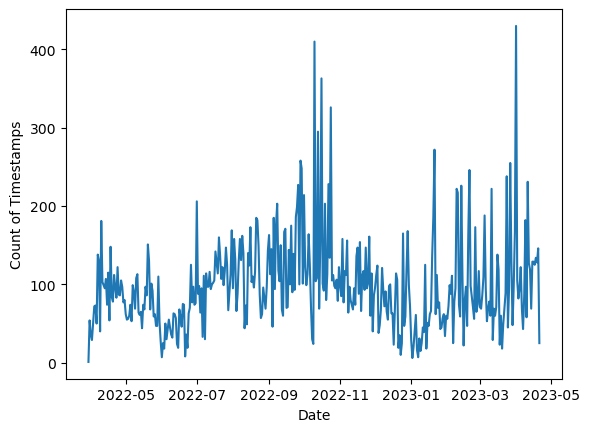

In [32]:
# create a new column for date from the timestamp column
df['date'] = df['timestamp'].dt.date

# group the data by date and compute the mean or sum of the data for each date
grouped_data = df.groupby('date')['timestamp'].count()

# create a line chart with the date on the x-axis and count of timestamps on the y-axis
grouped_data.plot(kind='line')

# add x-axis and y-axis labels
plt.xlabel('Date')
plt.ylabel('Count of Timestamps')

#### Make a line chart for the frequency of timestamps on each month

In [33]:
# create a new column for month from the timestamp column
df['month'] = df['timestamp'].dt.month

Text(0, 0.5, 'Count of Timestamps')

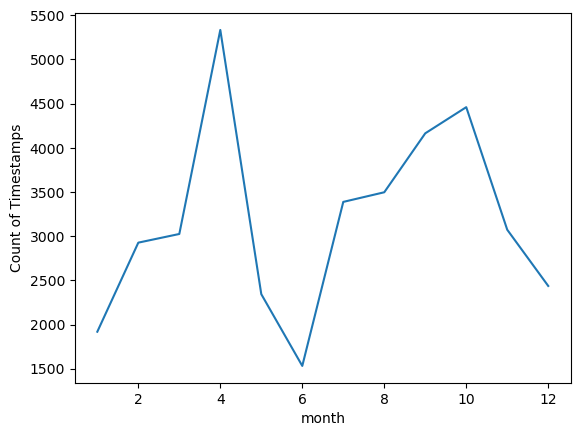

In [34]:
# group the data by date and compute the mean or sum of the data for each date
grouped_data = df.groupby('month')['timestamp'].count()

# create a line chart with the date on the x-axis and count of timestamps on the y-axis
grouped_data.plot(kind='line')

# add x-axis and y-axis labels
plt.xlabel('month')
plt.ylabel('Count of Timestamps')

#### Make a bar chart for the frequency of timestamps on each month

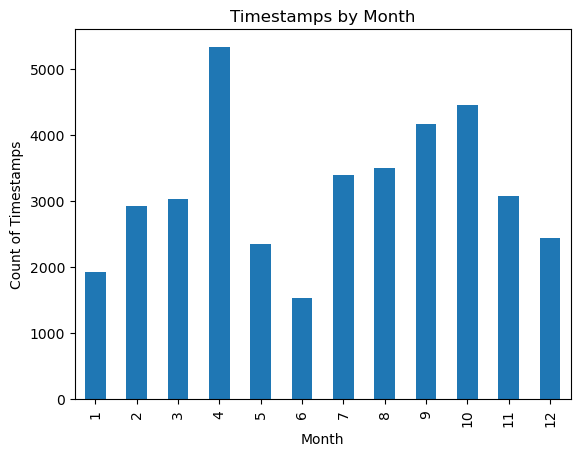

In [35]:
# create a bar chart with the month on the x-axis and count of timestamps on the y-axis
grouped_data.plot(kind='bar')

# add x-axis and y-axis labels
plt.xlabel('Month')
plt.ylabel('Count of Timestamps')

# set the title of the chart
plt.title('Timestamps by Month')

# show the chart
plt.show()

***

## Part 4: Analyze and visualize an additional element from  your personal data

### Name: Julian

- At least two clear questions that you ask and then answer via data analysis
- At least one form of data manipulation (calculating new values, doing a groupby, etc.)
- At least one visualization (you can use any tool you like: Observable, Seaborn, Flourish, etc.)

#### Two questions

1. I wanted to see what's frequently watched Youtube Channels from the data

2. I wanted to see what's frequently watched Youtube videos from the data

#### At least one form of data manipulation

Get the list of videos watched

In [36]:
video_names = []
for div in result:
    content = div.contents
    video_name = content[1].text
    video_names.append(video_name)
    
video_names

["NewJeans (뉴진스) 'Ditto' Performance Video (Fix ver.)",
 'Save the Last Dance for Me',
 'Everything',
 'Stock Market Forecast: What You Need to Know Before May 3rd',
 'Die A Happy Man',
 "Free Fallin' (Live at the Nokia Theatre, Los Angeles, CA - December 2007)",
 'The Lazy Song',
 "Can't Take My Eyes off You",
 'Memories',
 'History',
 'HON CA YEU',
 'Supermarket Flowers',
 'When You Say Nothing at All (Live in Nashville)',
 'More Than Words',
 'Forever Now',
 'Lucky',
 'I Want It That Way',
 'Home',
 'Ngày Mai Em Đi',
 'Chan Tinh',
 "The Man Who Can't Be Moved",
 'Kha | Giấc Mộng (Acoustic Version)',
 'Way down We Go',
 'Thinking out Loud',
 'Unlonely',
 'WW2 - OverSimplified (Part 1)',
 'Wildlife | Episode 1: Tiger, Lion, Leopard & Jaguar - The Four Big Cats | Free Documentary Nature',
 'Ngày Tuyệt Vời Nhất',
 'Any song (아무노래)',
 'Em Mơ Về Anh - Mỹ Linh || My Linh Tour 06',
 'Phố Không Em',
 'MIN - ĐỪNG YÊU NỮA, EM MỆT RỒI | OFFICIAL MUSIC VIDEO',
 'SƠN TÙNG M-TP | CHÚNG TA CỦA HIỆN

Create dataframe for videos watched

In [37]:
videos_df = pd.DataFrame({'Video Name': video_names})

In [38]:
videos_df[:5]

,Video Name
0,NewJeans (뉴진스) 'Ditto' Performance Video (Fix ...
1,Save the Last Dance for Me
2,Everything
3,Stock Market Forecast: What You Need to Know B...
4,Die A Happy Man


In [39]:
# get the count of each video using value_counts() and create a new dataframe
video_count_df = pd.DataFrame(videos_df['Video Name'].value_counts()).reset_index()

# rename the columns of the new dataframe
video_count_df.columns = ['Video Name', 'Count']

In [40]:
video_count_df[:10]

,Video Name,Count
0,,670
1,Ngày Tuyệt Vời Nhất,145
2,Leave Before You Love Me,124
3,Circles,115
4,ANH NHA O DAU THE,100
5,Sunflower (Spider-Man: Into the Spider-Verse),89
6,嘉宾,89
7,Perfect,84
8,Peaches,79
9,THẰNG ĐIÊN | JUSTATEE x PHƯƠNG LY | OFFICIAL MV,78


Text(0, 0.5, 'Count')

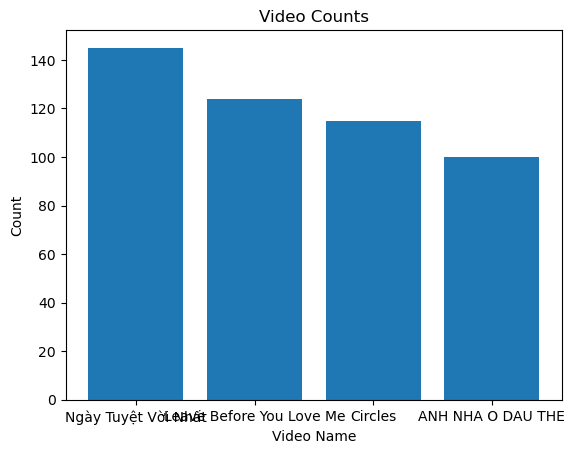

In [41]:
# create a bar chart with the month on the x-axis and count of timestamps on the y-axis
df_top_video = video_count_df[1:5]

# create a bar chart
fig, ax = plt.subplots()
ax.bar(df_top_video['Video Name'], df_top_video['Count'])

# set the title and axis labels
ax.set_title('Video Counts')
ax.set_xlabel('Video Name')
ax.set_ylabel('Count')

So it seems like the most watched videos seem are all music videos. 

Get the list of channels subscribed

In [42]:
channel_names = []
for div in result:
    try:
        content = div.contents[3]
        channel_names.append(content.text)
    except:
        continue

channel_names

['NewJeans',
 'Michael Bublé - Topic',
 'Michael Bublé - Topic',
 'ClearValue Tax',
 'Thomas Rhett - Topic',
 'John Mayer - Topic',
 'Bruno Mars - Topic',
 'Craymer - Topic',
 'Maroon 5 - Topic',
 'One Direction - Topic',
 'Đức Phúc - Topic',
 'Ed Sheeran - Topic',
 'Music Travel Love - Topic',
 'Joseph Vincent - Topic',
 'Michael Bublé - Topic',
 'Jason Mraz - Topic',
 'Backstreet Boys - Topic',
 'Michael Bublé - Topic',
 'Soobin Hoang Son - Topic',
 'Quang Trung - Topic',
 'The Script - Topic',
 'Various Artists - Topic',
 'KALEO - Topic',
 'Ed Sheeran - Topic',
 'Jason Mraz - Topic',
 'OverSimplified',
 'Free Documentary - Nature',
 'Rhymastic - Topic',
 'ZICO - Topic',
 'Mỹ Linh',
 'Thái Đinh - Topic',
 'MIN OFFICIAL',
 'Sơn Tùng M-TP Official',
 'DOUBLEX BAND - Topic',
 'Phạm Hồng Phước',
 'HYBE LABELS',
 'HYBE LABELS',
 'NewJeans',
 'The Real World',
 'Drill TV',
 'THE K-POP',
 'Abundant Vision',
 'Jordan B Peterson Clips',
 'EllisBassNGuitarClipsYT',
 'Wake Up Neo',
 'Julia Jewe

In [43]:
channels_df = pd.DataFrame({'Channel Name': channel_names})

In [44]:
channels_df[:5]

,Channel Name
0,NewJeans
1,Michael Bublé - Topic
2,Michael Bublé - Topic
3,ClearValue Tax
4,Thomas Rhett - Topic


In [45]:
# get the count of each channel using value_counts() and create a new dataframe
channel_count_df = pd.DataFrame(channels_df['Channel Name'].value_counts()).reset_index()

# rename the columns of the new dataframe
channel_count_df.columns = ['Channel Name', 'Count']

In [46]:
channel_count_df

,Channel Name,Count
0,Justin Bieber - Topic,567
1,Ed Sheeran - Topic,413
2,Taylor Swift - Topic,401
3,,395
4,JustinBieberVEVO,349
...,...,...
8075,Chi de Papillon,1
8076,♡AquaSecret♡,1
8077,Eric Ita,1
8078,TheCoderNamedBridget,1


For this part, without visualization, I could easily see that Justin Bieber is the most popular channel from the Youtube Data followed by Ed Sheeran.

***

### Name: Carl

- Two questions
    - Who is my most played artist?
    - What is my most played song?

In [7]:
spotify = pd.read_csv("output.csv")
spotify

,endTime,artistName,trackName,msPlayed
0,2023-01-03 04:26,Fujii Kaze,Shinunoga E-Wa,8815
1,2023-01-03 17:33,Música Piola Que No Estaba En Spotify,Seishun Buta Yarou wa Bunny Girl Senpai no Yum...,10726
2,2023-01-04 01:00,Música Piola Que No Estaba En Spotify,Seishun Buta Yarou wa Bunny Girl Senpai no Yum...,17595
3,2023-01-04 01:01,Pete & Bas,Mr Worldwide,32401
4,2023-01-04 01:01,Yoshii,Fukashigi No Carte,801
...,...,...,...,...
3021,2023-04-20 19:26,YUI,LIFE,31910
3022,2023-04-20 19:30,MAN WITH A MISSION,絆ノ奇跡,223320
3023,2023-04-20 19:32,YUI,LIFE,152440
3024,2023-04-20 19:35,Palmy Chiller,Why Do We Have to End?,179354


In [13]:
# Find the value counts for artists
value_counts = spotify['artistName'].value_counts()

# Find the top 5 most artists
top5Atists = value_counts.head(5)

print("Top 5 artists and the amount of their songs played:")
print(top5Atists)

# Find the value counts for songs
value_counts = spotify['trackName'].value_counts()

# Find the top 5 most repeating songs
top5Songs = value_counts.head(5)

print("Top 5 songs and amount of plays:")
print(top5Songs)

Top 5 artists and the amount of their songs played:
blink-182        280
Wallows          219
Palmy Chiller    148
Caitlin Myers    126
Tally Hall       126
Name: artistName, dtype: int64
Top 5 songs and amount of plays:
Cynical             47
Sofia               44
That Crazy Magic    44
WISH ME LUCK        37
Guessing Game       37
Name: trackName, dtype: int64


In [14]:
# Total Hours listened 
totalHours = spotify['msPlayed'].sum() /  3600000

print("Total hours listened:", totalHours)

Total hours listened: 123.57433333333333


Text(0, 0.5, 'Total Plays')

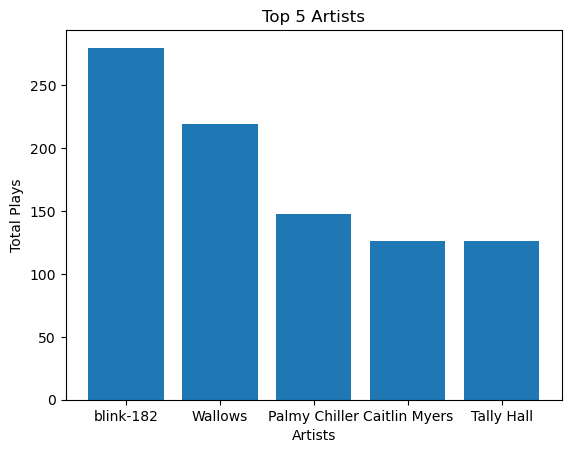

In [15]:
# Create a bar plot of the top 5 artists
plt.bar(top5Atists.index, top5Atists.values)

# Set plot title and axis labels
plt.title('Top 5 Artists')
plt.xlabel('Artists')
plt.ylabel('Total Plays')

Text(0, 0.5, 'Total Plays')

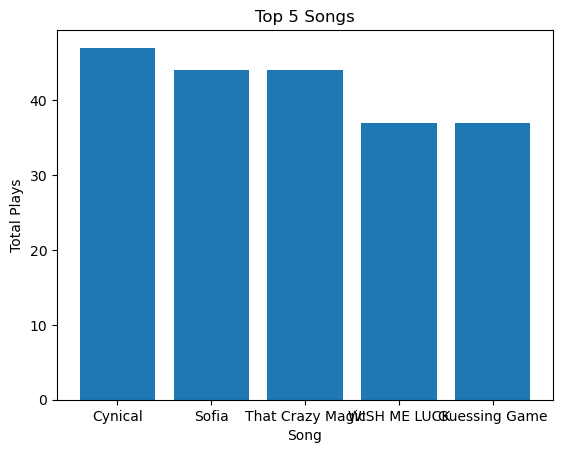

In [16]:
# Create a bar plot of the top 5 songs
plt.bar(top5Songs.index, top5Songs.values)

# Set plot title and axis labels
plt.title('Top 5 Songs')
plt.xlabel('Song')
plt.ylabel('Total Plays')